
<br>
<font>
<div dir=ltr align=center>
<font color=0F5298 size=7>
    Machine Learning <br> <br>
<font color=2565AE size=5>
    CE Department <br>
    Fall 2024 - Prof. Sharifi Zarchi<br>
<font color=3C99D size=5>
    HW4 Practical <br>
    Image Colorization<br>
    Image Segmentation<br>
<font color=696880 size=4>
    Shayan Shabani


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


This assignment is structured to introduce students to practical applications of generative models in computer vision.
It targets two challenging areas: colorization and segmentation, using architectures that are complex but very applicable in industry settings.
## Machine Learning Assignment #4: Practical Applications in Image Processing

## Learning Objectives:
By the end of this assignment, students will be able to:
1. Understand and implement Variational Autoencoders for image colorization.
2. Apply the U-Net architecture for image segmentation.
3. Preprocess image datasets, including augmentation techniques.
4. Analyze the performance of machine learning models using relevant metrics.
5. Explore the relationship between latent space and output quality in generative models.


# Image Colorization using VAE
In this section of the assignment, students will explore the fascinating field of image colorization using Variational Autoencoders (VAEs), a type of generative model in deep learning. The task involves transforming grayscale images into colored ones, leveraging the encoder-decoder architecture of VAEs, which are adept at learning complex data distributions. Students will implement and fine-tune an autoencoder network, utilizing components like perceptual loss and feature extraction from pre-trained models, to improve colorization output. By doing so, they will gain a deeper understanding of generative models and their practical applications in computer vision tasks. This exercise offers a hands-on opportunity to blend theoretical knowledge with practical coding skills, characterizing the creative potential of AI in image processing.

Dataset: https://drive.google.com/drive/folders/1KeJbfUykGnPlz0q08_b1IjtW8OxkPdQ9?usp=sharing

## Importing Libraries

In [1]:
!pip install torchsummary


In [2]:
!pip install gdown


In [3]:
!pip install pytorch_lightning
!pip install seaborn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 21.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 47.3 MB/s eta 0:00:00


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sea
from tqdm.notebook import tqdm
import os
import torch
import torch.nn as nn
import pytorch_lightning as pl
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch.nn.functional as F
import torchmetrics
from torchmetrics import Metric
import torchvision
import math
import gdown
import zipfile
from PIL import Image
from torchsummary import summary
print(plt.style.available)
plt.style.use('seaborn-v0_8')
device = 'cuda' if torch.cuda.is_available() else 'cpu'

np.__version__, device

['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn-v0_8', 'seaborn-v0_8-bright', 'seaborn-v0_8-colorblind', 'seaborn-v0_8-dark', 'seaborn-v0_8-dark-palette', 'seaborn-v0_8-darkgrid', 'seaborn-v0_8-deep', 'seaborn-v0_8-muted', 'seaborn-v0_8-notebook', 'seaborn-v0_8-paper', 'seaborn-v0_8-pastel', 'seaborn-v0_8-poster', 'seaborn-v0_8-talk', 'seaborn-v0_8-ticks', 'seaborn-v0_8-white', 'seaborn-v0_8-whitegrid', 'tableau-colorblind10']


('1.26.4', 'cuda')

## Loading the Data

In [5]:
url = "https://drive.google.com/uc?id=1Spj_HB5X5Zm1RETskUMt1y0ompktMSNi"
output = "archive.zip"
gdown.download(url, output, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1Spj_HB5X5Zm1RETskUMt1y0ompktMSNi
From (redirected): https://drive.google.com/uc?id=1Spj_HB5X5Zm1RETskUMt1y0ompktMSNi&confirm=t&uuid=7bb258c8-2de1-47fb-ae22-a816058e7f91
To: /content/archive.zip
100%|██████████| 73.9M/73.9M [00:02<00:00, 35.9MB/s]


'archive.zip'

In [6]:
zip_file_path = '/content/archive.zip'

extract_to = '/content'

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print("Extraction completed!")

Extraction completed!


In [7]:
import os
import pandas as pd
from tqdm import tqdm

def load_data(PATH):
    filenames = []
    labels = []

    for class_name in tqdm(os.listdir(PATH), desc="Loading data"):
        class_path = os.path.join(PATH, class_name)
        if os.path.isdir(class_path):
            for filename in os.listdir(class_path):
                if filename.endswith((".jpg", ".png", ".jpeg")):
                    filenames.append(os.path.join(class_path, filename))
                    labels.append(class_name)

    df = pd.DataFrame({'filename': filenames, 'label': labels})

    df = df.sample(frac=1).reset_index(drop=True)

    return df

train_path = '/content/archive/train'
valid_path = '/content/archive/valid'
test_path = '/content/archive/test'

train_df = load_data(train_path)
valid_df = load_data(valid_path)
test_df = load_data(test_path)

print(f"\nTrain DataFrame shape: {train_df.shape}")
print(f"Validation DataFrame shape: {valid_df.shape}")
print(f"Test DataFrame shape: {test_df.shape}")




Loading data: 100%|██████████| 20/20 [00:00<00:00, 24914.19it/s]


Train DataFrame shape: (3208, 2)
Validation DataFrame shape: (100, 2)
Test DataFrame shape: (100, 2)


In [8]:
combined_df = pd.concat([train_df, test_df], axis=0).reset_index(drop=True)

print(combined_df.shape)

(3308, 2)


In [9]:
combined_df.head()

,filename,label
0,/content/archive/train/AMERICAN KESTREL/109.jpg,AMERICAN KESTREL
1,/content/archive/train/AFRICAN PIED HORNBILL/1...,AFRICAN PIED HORNBILL
2,/content/archive/train/AFRICAN PYGMY GOOSE/136...,AFRICAN PYGMY GOOSE
3,/content/archive/train/AMERICAN AVOCET/078.jpg,AMERICAN AVOCET
4,/content/archive/train/AMERICAN KESTREL/148.jpg,AMERICAN KESTREL


## Plot some of the images

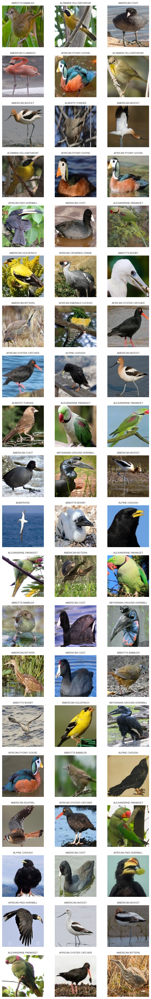

In [10]:
def show_images_with_labels(df, num_images=60, rows=20, cols=3):
    if rows * cols != num_images:
        raise ValueError("Number of images must equal rows * cols")

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))
    axes = axes.flatten()
    samples = df.sample(n=num_images).reset_index(drop=True)

    for i, ax in enumerate(axes):
        img_path = samples.loc[i, 'filename']
        label = samples.loc[i, 'label']
        img = Image.open(img_path)

        ax.imshow(img)
        ax.set_title(label, fontsize=8)
        ax.axis('off')

    plt.show()

show_images_with_labels(combined_df, num_images=60, rows=20, cols=3)


## Dataset Distribution
plot the distribution of the dataset, both training and validation set

<ipython-input-11-4333c83fffff>:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90, ha='right', fontsize=8)
<ipython-input-11-4333c83fffff>:21: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90, ha='right', fontsize=8)


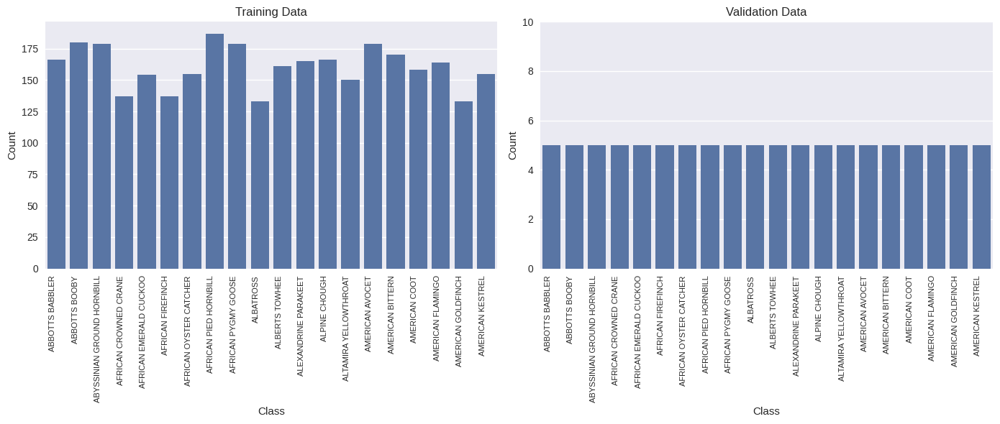

In [11]:

import matplotlib.pyplot as plt
import seaborn as sns

def plot_class_distribution_separate(train_df, valid_df, ylim_valid=None):  # Add ylim_valid parameter

    train_counts = train_df['label'].value_counts().sort_index()
    valid_counts = valid_df['label'].value_counts().sort_index()

    fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=False)  # Set sharey to False

    sns.barplot(x=train_counts.index, y=train_counts.values, ax=axes[0])
    axes[0].set_title('Training Data')
    axes[0].set_xlabel('Class')
    axes[0].set_ylabel('Count')
    axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90, ha='right', fontsize=8)

    sns.barplot(x=valid_counts.index, y=valid_counts.values, ax=axes[1])
    axes[1].set_title('Validation Data')
    axes[1].set_xlabel('Class')
    axes[1].set_ylabel('Count')
    axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90, ha='right', fontsize=8)

    if ylim_valid:
        axes[1].set_ylim(0, ylim_valid)

    plt.tight_layout()
    plt.show()

plot_class_distribution_separate(train_df, valid_df, ylim_valid=10)

## Dataset Preparation
Now we are going to build the dataset by using `Dataset` and `DataLoader` classes within PyTorch. I recommend you to randomly crop the images to (160, 160) and then normalize them.

In [50]:
class BirdDataset(Dataset):
    def __init__(self, df, transform=None):
        """
        Args:
            df (DataFrame): DataFrame containing 'filename' and 'label' columns.
            transform (callable, optional): Optional transforms to be applied on an image.
        """
        self.df = df
        self.transform = transform
        self.label_mapping = {label: idx for idx, label in enumerate(df['label'].unique())}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample to fetch.

        Returns:
            torch.Tensor: Transformed grayscale image tensor.
            int: Corresponding label of the image.
        """
        img_path = self.df.iloc[idx]['filename']
        label = self.df.iloc[idx]['label']
        label = self.label_mapping[label]

        # Convert image to grayscale
        img = Image.open(img_path).convert('RGB')  # "L" converts image to grayscale

        gray_img = img.convert('L')

        if self.transform:
            img = self.transform(img)
            gray_img = self.transform(gray_img)
        return gray_img, img


train_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1)
])

valid_transform =  transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.ToTensor()])


train_dataset = BirdDataset(train_df, transform=train_transform)
valid_dataset = BirdDataset(valid_df, transform=valid_transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=False, num_workers=2)


**Why is data augmentation pivotal in training models for image tasks, and what techniques are beneficial for this particular assignment?**

Data augmentation is crucial because it increases dataset diversity, reduces overfitting, and improves model robustness by simulating real-world variations. For this assignment, key techniques include random cropping, color jittering, and flipping, rotation, all of which help the model generalize and perform better on the colorization task.

## Model Architecture
The model has an encoder block for encoding the grayscale image into a lower representation followed by a decoder block to generate the colorized image.

In [43]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [97]:
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
from torchvision.models import vgg16

class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        self.layer1 = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.layer2 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.layer3 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.layer4 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )

    def forward(self, x):
        features1 = self.layer1(x)
        features2 = self.layer2(features1)
        features3 = self.layer3(features2)
        latent_features = self.layer4(features3)
        return latent_features, [features1, features2, features3]

class Decoder(nn.Module):
    def __init__(self):
        super(Decoder, self).__init__()
        self.latent_adjust = nn.Conv2d(512, 256, kernel_size=1)
        self.skip_adjust3 = nn.Conv2d(256, 256, kernel_size=1)
        self.skip_adjust2 = nn.Conv2d(128, 256, kernel_size=1)
        self.skip_adjust1 = nn.Conv2d(64, 128, kernel_size=1)
        self.up1 = nn.Sequential(
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.ReLU()
        )
        self.up2 = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.ReLU()
        )
        self.up3 = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU()
        )
        self.output_layer = nn.Sequential(
            nn.ConvTranspose2d(64, 3, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Tanh()
        )

    def forward(self, x, skip_connections, output_dims):
        x = self.latent_adjust(x)
        x = nn.functional.interpolate(x, size=skip_connections[2].shape[2:])
        x = self.up1(x + self.skip_adjust3(skip_connections[2]))
        x = nn.functional.interpolate(x, size=skip_connections[1].shape[2:])
        x = self.up2(x + self.skip_adjust2(skip_connections[1]))
        x = nn.functional.interpolate(x, size=skip_connections[0].shape[2:])
        x = self.up3(x + self.skip_adjust1(skip_connections[0]))
        x = nn.functional.interpolate(x, size=output_dims, mode='bilinear', align_corners=False)
        x = self.output_layer(x)
        return x

class PerceptualLoss(nn.Module):
    def __init__(self, selected_layers=None):
        super(PerceptualLoss, self).__init__()
        self.vgg = vgg16(pretrained=True).features.eval()
        self.feature_layers = selected_layers if selected_layers else [3, 8, 12, 15, 22, 28]
        for param in self.vgg.parameters():
            param.requires_grad = False

    def forward(self, generated, reference):
        gen_features = self.extract_features(generated)
        ref_features = self.extract_features(reference)
        loss = sum(nn.functional.mse_loss(g, r) for g, r in zip(gen_features, ref_features))
        return loss

    def extract_features(self, x):
        extracted = []
        for index, layer in enumerate(self.vgg):
            x = layer(x)
            if index in self.feature_layers:
                extracted.append(x.clone())
        return extracted

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()
        self.loss_function = PerceptualLoss()

    def forward(self, x, target_dims):
        latent, skips = self.encoder(x)
        output = self.decoder(latent, skips, target_dims)
        return output

    def calculate_loss(self, prediction, actual):
        prediction = nn.functional.interpolate(prediction, size=actual.shape[2:], mode='bilinear', align_corners=False)
        mse = nn.functional.mse_loss(prediction, actual)
        perceptual = self.loss_function(prediction, actual)
        return mse + perceptual

    def train_model(self, train_loader, valid_loader, num_epochs=10, lr=1e-3):
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.to(device)

        optimizer = optim.Adam(self.parameters(), lr=lr)
        training_loss, validation_loss = [], []

        for epoch in range(num_epochs):
            epoch_train_loss = 0
            epoch_valid_loss = 0

            self.train()
            for inputs, targets in tqdm(train_loader):
                inputs, targets = inputs.to(device), targets.to(device)
                optimizer.zero_grad()
                predictions = self(inputs, target_dims=targets.shape[2:])
                loss = self.calculate_loss(predictions, targets)
                loss.backward()
                optimizer.step()
                epoch_train_loss += loss.item()

            self.eval()
            with torch.no_grad():
                for inputs, targets in tqdm(valid_loader):
                    inputs, targets = inputs.to(device), targets.to(device)
                    predictions = self(inputs, target_dims=targets.shape[2:])
                    loss = self.calculate_loss(predictions, targets)
                    epoch_valid_loss += loss.item()

            training_loss.append(epoch_train_loss / len(train_loader))
            validation_loss.append(epoch_valid_loss / len(valid_loader))

            print(f"Epoch {epoch + 1}/{num_epochs} - Train Loss: {training_loss[-1]:.4f}, Valid Loss: {validation_loss[-1]:.4f}")

        return training_loss, validation_loss


In [98]:
model = Net().to(device)

print(model)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Net(
  (encoder): Encoder(
    (layer1): Sequential(
      (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU()
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU()
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (layer2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU()
      (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU()
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (layer3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU()
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (layer4): Sequential(
      (0): Conv2d

## Training Phase

In [99]:
model = Net().to(device)

train_losses, valid_losses = model.train_model(train_loader, valid_loader, num_epochs=50)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
100%|██████████| 4/4 [00:00<00:00,  4.13it/s]


Epoch 1/50 - Train Loss: 17.1808, Valid Loss: 10.7384


100%|██████████| 4/4 [00:01<00:00,  3.66it/s]


Epoch 2/50 - Train Loss: 7.6048, Valid Loss: 8.2453


100%|██████████| 4/4 [00:01<00:00,  3.66it/s]


Epoch 3/50 - Train Loss: 6.4117, Valid Loss: 6.6864


100%|██████████| 4/4 [00:01<00:00,  3.47it/s]


Epoch 4/50 - Train Loss: 6.0614, Valid Loss: 7.6032


100%|██████████| 4/4 [00:01<00:00,  3.42it/s]


Epoch 5/50 - Train Loss: 5.7926, Valid Loss: 6.4500


100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


Epoch 6/50 - Train Loss: 5.7200, Valid Loss: 6.3802


100%|██████████| 4/4 [00:00<00:00,  4.16it/s]


Epoch 7/50 - Train Loss: 5.5451, Valid Loss: 6.9815


100%|██████████| 4/4 [00:00<00:00,  4.17it/s]


Epoch 8/50 - Train Loss: 5.5390, Valid Loss: 6.5934


100%|██████████| 4/4 [00:00<00:00,  4.26it/s]


Epoch 9/50 - Train Loss: 5.4314, Valid Loss: 6.1482


100%|██████████| 4/4 [00:00<00:00,  4.11it/s]


Epoch 10/50 - Train Loss: 5.3738, Valid Loss: 6.2601


100%|██████████| 4/4 [00:01<00:00,  3.68it/s]


Epoch 11/50 - Train Loss: 5.3359, Valid Loss: 6.1636


100%|██████████| 4/4 [00:01<00:00,  3.28it/s]


Epoch 12/50 - Train Loss: 5.2773, Valid Loss: 6.1991


100%|██████████| 4/4 [00:01<00:00,  3.83it/s]


Epoch 13/50 - Train Loss: 5.2235, Valid Loss: 5.7408


100%|██████████| 4/4 [00:00<00:00,  4.16it/s]


Epoch 14/50 - Train Loss: 5.2332, Valid Loss: 6.7678


100%|██████████| 4/4 [00:00<00:00,  4.10it/s]


Epoch 15/50 - Train Loss: 5.1642, Valid Loss: 6.0831


100%|██████████| 4/4 [00:00<00:00,  4.13it/s]


Epoch 16/50 - Train Loss: 5.1703, Valid Loss: 5.6088


100%|██████████| 4/4 [00:01<00:00,  3.48it/s]


Epoch 17/50 - Train Loss: 5.0518, Valid Loss: 5.7184


100%|██████████| 4/4 [00:01<00:00,  3.68it/s]


Epoch 18/50 - Train Loss: 4.9833, Valid Loss: 6.4644


100%|██████████| 4/4 [00:01<00:00,  3.24it/s]


Epoch 19/50 - Train Loss: 5.0372, Valid Loss: 5.5778


100%|██████████| 4/4 [00:01<00:00,  3.13it/s]


Epoch 20/50 - Train Loss: 4.9674, Valid Loss: 5.5400


100%|██████████| 4/4 [00:01<00:00,  3.18it/s]


Epoch 21/50 - Train Loss: 4.9307, Valid Loss: 5.3773


100%|██████████| 4/4 [00:00<00:00,  4.13it/s]


Epoch 22/50 - Train Loss: 4.8595, Valid Loss: 6.1270


100%|██████████| 4/4 [00:00<00:00,  4.12it/s]


Epoch 23/50 - Train Loss: 4.8492, Valid Loss: 5.4451


100%|██████████| 4/4 [00:00<00:00,  4.15it/s]


Epoch 24/50 - Train Loss: 4.8057, Valid Loss: 5.9328


100%|██████████| 4/4 [00:01<00:00,  3.61it/s]


Epoch 25/50 - Train Loss: 4.7510, Valid Loss: 5.6756


100%|██████████| 4/4 [00:01<00:00,  3.36it/s]


Epoch 26/50 - Train Loss: 4.7262, Valid Loss: 5.7366


100%|██████████| 4/4 [00:01<00:00,  3.36it/s]


Epoch 27/50 - Train Loss: 4.7435, Valid Loss: 5.8798


100%|██████████| 4/4 [00:01<00:00,  3.34it/s]


Epoch 28/50 - Train Loss: 4.6509, Valid Loss: 5.6320


100%|██████████| 4/4 [00:01<00:00,  3.20it/s]


Epoch 29/50 - Train Loss: 4.6858, Valid Loss: 5.8875


100%|██████████| 4/4 [00:01<00:00,  3.09it/s]


Epoch 30/50 - Train Loss: 4.6125, Valid Loss: 5.5997


100%|██████████| 4/4 [00:01<00:00,  3.47it/s]


Epoch 31/50 - Train Loss: 4.4302, Valid Loss: 6.7369


100%|██████████| 4/4 [00:00<00:00,  4.16it/s]


Epoch 32/50 - Train Loss: 4.4739, Valid Loss: 5.3986


100%|██████████| 4/4 [00:00<00:00,  4.16it/s]


Epoch 33/50 - Train Loss: 4.3876, Valid Loss: 6.5992


100%|██████████| 4/4 [00:00<00:00,  4.14it/s]


Epoch 34/50 - Train Loss: 4.3758, Valid Loss: 6.0247


100%|██████████| 4/4 [00:01<00:00,  3.72it/s]


Epoch 35/50 - Train Loss: 4.3421, Valid Loss: 5.4987


100%|██████████| 4/4 [00:01<00:00,  3.61it/s]


Epoch 36/50 - Train Loss: 4.3520, Valid Loss: 6.0598


100%|██████████| 4/4 [00:01<00:00,  3.98it/s]


Epoch 37/50 - Train Loss: 4.2767, Valid Loss: 5.5462


100%|██████████| 4/4 [00:00<00:00,  4.16it/s]


Epoch 38/50 - Train Loss: 4.1993, Valid Loss: 6.3260


100%|██████████| 4/4 [00:00<00:00,  4.15it/s]


Epoch 39/50 - Train Loss: 4.2279, Valid Loss: 5.6241


100%|██████████| 4/4 [00:00<00:00,  4.18it/s]


Epoch 40/50 - Train Loss: 4.1663, Valid Loss: 5.3235


100%|██████████| 4/4 [00:01<00:00,  3.73it/s]


Epoch 41/50 - Train Loss: 4.1248, Valid Loss: 5.7799


100%|██████████| 4/4 [00:01<00:00,  3.50it/s]


Epoch 42/50 - Train Loss: 4.1201, Valid Loss: 6.0206


100%|██████████| 4/4 [00:01<00:00,  3.06it/s]


Epoch 43/50 - Train Loss: 4.0915, Valid Loss: 5.7312


100%|██████████| 4/4 [00:01<00:00,  3.34it/s]


Epoch 44/50 - Train Loss: 4.0656, Valid Loss: 5.7207


100%|██████████| 4/4 [00:01<00:00,  3.19it/s]


Epoch 45/50 - Train Loss: 4.0511, Valid Loss: 5.4239


100%|██████████| 4/4 [00:01<00:00,  3.04it/s]


Epoch 46/50 - Train Loss: 3.9535, Valid Loss: 6.0362


100%|██████████| 4/4 [00:01<00:00,  3.36it/s]


Epoch 47/50 - Train Loss: 3.9777, Valid Loss: 5.6386


100%|██████████| 4/4 [00:01<00:00,  3.35it/s]


Epoch 48/50 - Train Loss: 3.9216, Valid Loss: 5.4919


100%|██████████| 4/4 [00:01<00:00,  3.34it/s]


Epoch 49/50 - Train Loss: 3.8683, Valid Loss: 6.0281


100%|██████████| 4/4 [00:01<00:00,  3.22it/s]

Epoch 50/50 - Train Loss: 3.9203, Valid Loss: 5.7122


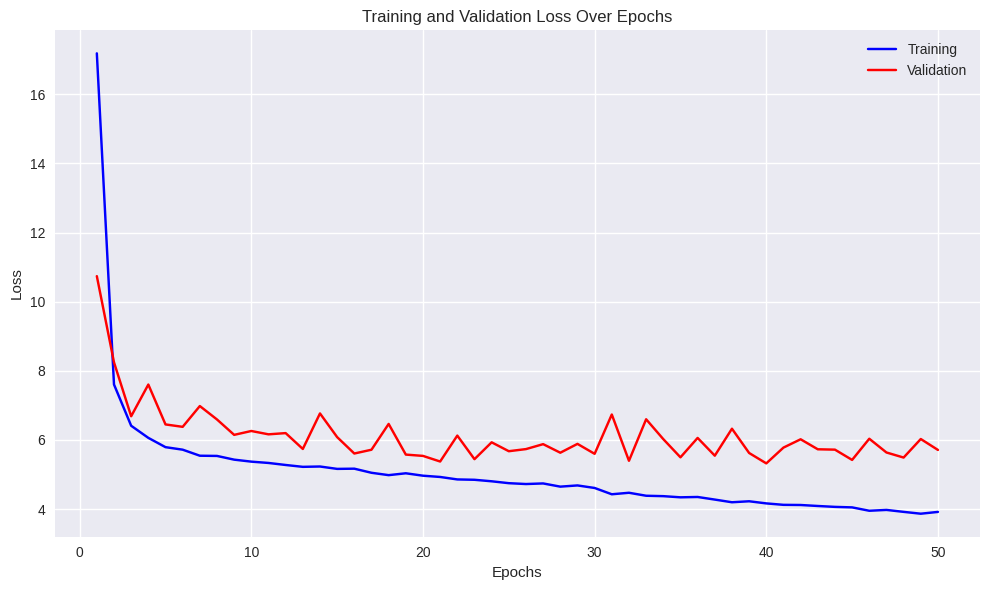

In [100]:
def plot_losses(train_losses, valid_losses):

    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(10, 6))
    plt.plot(epochs, train_losses, label='Training',color='b')
    plt.plot(epochs, valid_losses, label='Validation',color='r')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

plot_losses(train_losses, valid_losses)

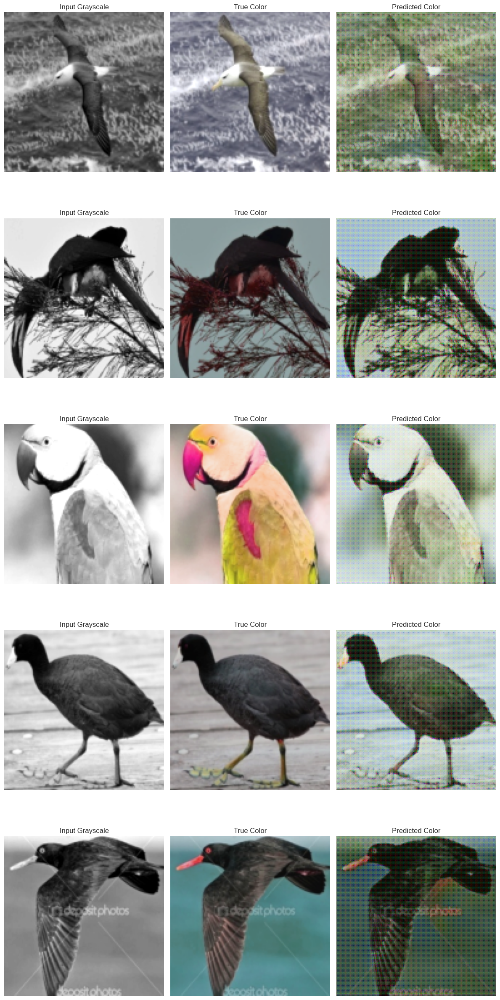

In [102]:
import matplotlib.pyplot as plt
import torch

def display_results(net, loader, sample_count=5):
    net.eval()
    imgs, labels = next(iter(loader))
    imgs, labels = imgs.to(device), labels.to(device)

    with torch.no_grad():
        outputs = net(imgs, target_dims=labels.shape[2:])


    imgs = imgs.cpu().numpy()
    labels = labels.cpu().numpy()
    outputs = outputs.cpu().numpy()

    fig, grid = plt.subplots(sample_count, 3, figsize=(12, 5 * sample_count))

    for index in range(sample_count):

        grid[index, 0].imshow(imgs[index, 0], cmap="gray")
        grid[index, 0].set_title("Input Grayscale")
        grid[index, 0].axis("off")

        grid[index, 1].imshow(labels[index].transpose(1, 2, 0))
        grid[index, 1].set_title("True Color")
        grid[index, 1].axis("off")

        grid[index, 2].imshow(outputs[index].transpose(1, 2, 0))
        grid[index, 2].set_title("Predicted Color")
        grid[index, 2].axis("off")

    plt.tight_layout()
    plt.show()

display_results(model, loader=valid_loader, sample_count=5)


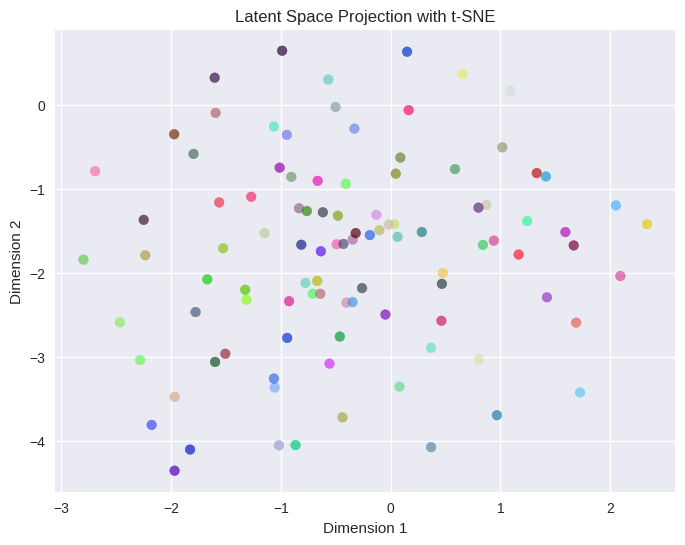

In [103]:
from sklearn.manifold import TSNE

def visualize_embedding_space(latent_model, data_iterator, max_points=1000):

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    latent_model.to(device)
    latent_model.eval()

    latent_data = []
    data_labels = []
    count = 0

    with torch.no_grad():
        for images, _ in data_iterator:
            images = images.to(device)
            latent_output, _ = latent_model(images)
            latent_output = latent_output.view(latent_output.size(0), -1)
            latent_data.append(latent_output.cpu())
            count += latent_output.size(0)

            if count >= max_points:
                break

    latent_data = torch.cat(latent_data, dim=0)[:max_points]
    tsne = TSNE(n_components=2, random_state=42)
    projected = tsne.fit_transform(latent_data.numpy())

    colors = np.random.rand(len(projected), 3)

    plt.figure(figsize=(8, 6))
    plt.scatter(projected[:, 0], projected[:, 1], c=colors, alpha=0.7)
    plt.title("Latent Space Projection with t-SNE")
    plt.xlabel("Dimension 1")
    plt.ylabel("Dimension 2")
    plt.grid(True)
    plt.show()

visualize_embedding_space(latent_model=model.encoder, data_iterator=valid_loader, max_points=1000)

How the distribution of points in the latent space reflects the VAE's capability to generalize grayscale images into colored outputs.

1. **Clustering and Class Representation**:
    - Can you identify clusters in the latent space that correspond to specific image features or categories?
    Yes, clusters in the latent space often correspond to specific image features or categories, as the encoder learns to group similar inputs based on shared characteristics, enabling better discrimination and reconstruction. Visualization tools like t-SNE or PCA can reveal these clusters.

  
    - How do these clusters inform us about the VAE's ability to differentiate between various input characteristics related to color information?
    These clusters demonstrate the VAE's ability to encode distinct color information by grouping inputs with similar color patterns or distributions in the latent space. Well-separated clusters indicate that the VAE effectively captures and differentiates color-related characteristics.


2. **Continuity and Transitions**:
    - Analyze whether neighboring points in the latent space result in similar or different color outputs. What does this continuity suggest about the latent representation's smoothness?

    Neighboring points in the latent space typically result in similar color outputs, suggesting that the latent representation is smooth and well-structured. This continuity indicates that the VAE has learned a meaningful, continuous mapping from the latent space to the output space, enabling gradual transitions between features.

    - How could these visual transitions impact the quality and realism of the generated colorations, especially for input images that exhibit gradual changes (e.g., transitions in lighting or shading)?

    These smooth visual transitions enhance the quality and realism of the generated colorations by capturing gradual changes in features like lighting or shading. This ensures that the outputs blend naturally, avoiding abrupt or unrealistic changes, and closely mimic real-world variations.

3. **Effectiveness of Dimensionality Reduction**:
    - Assess the effectiveness of t-SNE in projecting high-dimensional latent vectors into a comprehensible 2D representation. What limitations might exist, and how do they affect your interpretation?

    t-SNE is effective for visualizing high-dimensional latent vectors by preserving local relationships, making clusters more comprehensible in 2D. However, it has limitations, such as difficulty preserving global structure, sensitivity to hyperparameters, and computational cost for large datasets. These issues can lead to misleading interpretations about the overall distribution of the latent space.


Elaborate on how the encoder-decoder architecture facilitates the learning of complex data distributions in image colorization. How does this architecture differ from a simple autoencoder?

The encoder-decoder architecture facilitates learning complex data distributions by progressively compressing input images into a latent representation (encoder) and reconstructing outputs with detailed spatial features (decoder). Unlike a simple autoencoder, it often includes skip connections, upsampling layers, and specialized loss functions (e.g., perceptual loss) to preserve spatial information and capture color nuances, making it better suited for tasks like image colorization.

Analyze the role of perceptual loss in enhancing the quality of colorized images. How does perceptual loss measure image similarity compared to pixel-wise losses like Mean Squared Error (MSE)?

Perceptual loss enhances the quality of colorized images by comparing high-level feature representations extracted from a pretrained network, such as VGG, rather than just pixel intensities. Unlike MSE, which measures pixel-wise differences, perceptual loss evaluates similarity in terms of semantic content and structure, ensuring more visually realistic and coherent colorizations that align with human perception.

Discuss how the latent space in a VAE impacts the fidelity and diversity of generated color images. What effects could varying the dimensionality of the latent space have?

The latent space in a VAE directly affects the fidelity and diversity of generated color images. A well-structured latent space enables the model to generate diverse and realistic outputs by effectively encoding meaningful variations in the data.

Increasing the latent space dimensionality enhances diversity, allowing the model to capture more nuanced features, but may lead to overfitting or underutilized dimensions. Conversely, reducing dimensionality improves regularization and can focus on the most critical features, but might sacrifice fidelity by oversimplifying the data representation. Balancing latent space size is key to achieving high-quality and varied outputs.

# Image Segmentation with U-Net
Image segmentation is a crucial task in computer vision aimed at dividing an image into meaningful segments or objects. The U-Net architecture, famed for its utility in medical imaging, excels at this by leveraging its encoder-decoder structure, which efficiently learns and reconstructs image details. In this task, the U-Net is trained on pairs of images and masks, enabling it to delineate object boundaries at the pixel level with high precision. The training process involves preprocessing the data, adjusting network parameters, and evaluating the model using metrics like Intersection over Union (IoU) to ensure effective segmentation. Successful implementation of U-Net for this purpose can revolutionize applications in areas like autonomous vehicles, medical diagnosis, and agricultural monitoring.

Dataset: https://drive.google.com/drive/folders/1g97fGNQ6buixT8Hp96QyEYOMNKby5Oe8?usp=sharing

## Importing necessary libraries

In [ ]:
# import system libs
import os
import time
import glob
import shutil

# import data handling tools
import cv2
import PIL
import numpy as np
import pandas as pd
import seaborn as sns
sns.set_style('darkgrid')
import matplotlib.pyplot as plt
# import necessary PyTorch libraries
...
print ('modules loaded')

modules loaded


In [ ]:
url = "https://drive.google.com/uc?id=16E-YYB9gzLdMUjSs5iKz_Ffusft86GR3"
output = "archive_seg.zip"
gdown.download(url, output, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=16E-YYB9gzLdMUjSs5iKz_Ffusft86GR3
From (redirected): https://drive.google.com/uc?id=16E-YYB9gzLdMUjSs5iKz_Ffusft86GR3&confirm=t&uuid=d06e5ee0-cd61-4912-8563-0ce316fc0e80
To: /content/archive_seg.zip
100%|██████████| 113M/113M [00:01<00:00, 59.8MB/s]


'archive_seg.zip'

In [ ]:
zip_file_path = '/content/archive_seg.zip'

extract_to = '/content'

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print("Extraction completed!")

Extraction completed!


## Load the Dataset

Found 290 images and 290 masks.


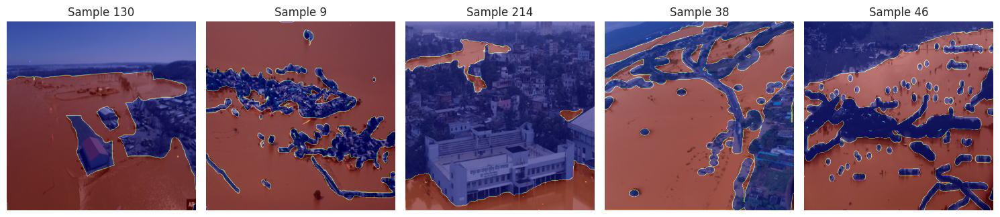

In [ ]:

def create_data(data_dir):
    """
    Traverse through the given data directory to extract and return paths to images and masks.
    Args:
        data_dir (str): Path to the data directory containing image and mask folders.

    Returns:
        Tuple: Lists of image paths and mask paths.
    """
    image_paths = []
    mask_paths = []

    for root, _, files in os.walk(data_dir):
        for file in files:
            if file.endswith(('.png', '.jpg', '.jpeg')):
                if "mask" in root.lower():
                    mask_paths.append(os.path.join(root, file))
                else:
                    image_paths.append(os.path.join(root, file))

    return sorted(image_paths), sorted(mask_paths)

def load_image(image_path, SIZE):
    """
    Load and resize an individual image to the specified size.
    Args:
        image_path (str): Path to the image file.
        SIZE (int): Target size for the image (width and height).

    Returns:
        np.ndarray: Resized and normalized image array.
    """
    img = Image.open(image_path).convert("RGB")
    img = img.resize((SIZE, SIZE))
    img_array = np.array(img) / 255.0

def load_images(image_paths, SIZE, mask=False, trim=None):
    """
    Batch process a list of image paths, loading and organizing images into a numpy array.
    Args:
        image_paths (list): List of image file paths.
        SIZE (int): Target size for the images (width and height).
        mask (bool): Whether the images are masks (binary images).
        trim (int): Optionally trim the list of images to handle a subset of data.

    Returns:
        np.ndarray: Array of processed images or masks.
    """
    if trim:
        image_paths = image_paths[:trim]

    images = []
    for path in image_paths:
        img = load_image(path, SIZE)
        if mask:
            img = np.expand_dims(img[:, :, 0], axis=-1)
        images.append(img)

    return np.array(images)

def show_image(image, title=None, cmap=None, alpha=1):
    """
    Display a single image using matplotlib.
    Args:
        image (np.ndarray): Image array.
        title (str): Optional title for the image.
        cmap (str): Colormap for displaying the image.
        alpha (float): Transparency for the image.

    Returns:
        None
    """
    plt.imshow(image, cmap=cmap, alpha=alpha)
    if title:
        plt.title(title)
    plt.axis("off")
    plt.show()

def show_mask(image, mask, cmap="jet", alpha=0.4):
    """
    Overlay a mask on an image to visualize segmentation results.
    Args:
        image (np.ndarray): Image array.
        mask (np.ndarray): Mask array.
        cmap (str): Colormap for the mask.
        alpha (float): Transparency for the mask.

    Returns:
        None
    """
    plt.imshow(image)
    plt.imshow(mask, cmap=cmap, alpha=alpha)
    plt.axis("off")
    plt.show()

def show_images_with_masks(imgs, msks, num_samples=5, alpha=0.5):
    """
    Overlay masks onto images and display them.

    Args:
        imgs (np.ndarray): Array of images.
        msks (np.ndarray): Array of masks.
        num_samples (int): Number of image-mask pairs to display.
        alpha (float): Transparency level for the mask overlay (0: invisible, 1: fully opaque).

    Returns:
        None
    """
    indices = np.random.choice(len(imgs), num_samples, replace=False)
    fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))

    for i, idx in enumerate(indices):
        image = imgs[idx]
        mask = msks[idx]

        axes[i].imshow(image)
        axes[i].imshow(mask, cmap="jet", alpha=alpha)
        axes[i].set_title(f"Sample {idx}")
        axes[i].axis("off")

    plt.tight_layout()
    plt.show()


SIZE = 256
DATA_DIR = "/content/seg_archive"

image_paths, mask_paths = create_data(DATA_DIR)
print(f"Found {len(image_paths)} images and {len(mask_paths)} masks.")

images = load_images(image_paths, SIZE)
masks = load_images(mask_paths, SIZE, mask=True)


show_images_with_masks(images, masks, num_samples=5, alpha=0.5)


## The Architecture
In addition to U-Net, we are going to utilize Attention Gates.
You probably need to read this paper: https://arxiv.org/pdf/1804.03999v3

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class LossDice(nn.Module):
    def __init__(self, epsilon=1e-6):
        super(LossDice, self).__init__()
        self.epsilon = epsilon

    def forward(self, outputs, labels):
        outputs = torch.sigmoid(outputs)
        overlap = torch.sum(outputs * labels)
        score = (2. * overlap + self.epsilon) / (torch.sum(outputs) + torch.sum(labels) + self.epsilon)
        return 1 - score

class LossJaccard(nn.Module):
    def __init__(self, epsilon=1e-6):
        super(LossJaccard, self).__init__()
        self.epsilon = epsilon

    def forward(self, outputs, labels):
        outputs = torch.sigmoid(outputs)
        overlap = torch.sum(outputs * labels)
        union = torch.sum(outputs) + torch.sum(labels) - overlap
        jaccard = (overlap + self.epsilon) / (union + self.epsilon)
        return 1 - jaccard

class BlockEncoder(nn.Module):
    def __init__(self, in_channels, out_channels, dropout=0.0):
        super(BlockEncoder, self).__init__()
        self.layers = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )
        self.pooling = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        features = self.layers(x)
        pooled = self.pooling(features)
        return features, pooled

class BlockDecoder(nn.Module):
    def __init__(self, input_channels, output_channels):
        super(BlockDecoder, self).__init__()
        self.upsample = nn.ConvTranspose2d(input_channels, output_channels, kernel_size=2, stride=2)
        self.layers = nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(output_channels, output_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )

    def forward(self, x, skip):
        x = self.upsample(x)
        diff_h = skip.size(2) - x.size(2)
        diff_w = skip.size(3) - x.size(3)
        x = F.pad(x, [diff_w // 2, diff_w - diff_w // 2, diff_h // 2, diff_h - diff_h // 2])
        x = torch.cat((x, skip), dim=1)
        return self.layers(x)

class GateAttention(nn.Module):
    def __init__(self, skip_channels, gating_channels, intermediate_channels):
        super(GateAttention, self).__init__()
        self.conv_skip = nn.Conv2d(skip_channels, intermediate_channels, kernel_size=1, bias=True)
        self.conv_gate = nn.Conv2d(gating_channels, intermediate_channels, kernel_size=1, bias=True)
        self.psi = nn.Conv2d(intermediate_channels, 1, kernel_size=1, bias=True)
        self.activation = nn.ReLU(inplace=True)
        self.attention = nn.Sigmoid()

    def forward(self, skip_features, gating_features):
        skip = self.conv_skip(skip_features)
        gate = self.conv_gate(gating_features)
        diff_h = skip.size(2) - gate.size(2)
        diff_w = skip.size(3) - gate.size(3)
        gate = F.pad(gate, [diff_w // 2, diff_w - diff_w // 2, diff_h // 2, diff_h - diff_h // 2])
        combined = self.activation(skip + gate)
        psi = self.attention(self.psi(combined))
        return skip_features * psi

class AttentionUModel(nn.Module):
    def __init__(self, input_channels, output_channels, base_filters=64, dropout_rate=0.0):
        super(AttentionUModel, self).__init__()
        self.enc1 = BlockEncoder(input_channels, base_filters, dropout_rate)
        self.enc2 = BlockEncoder(base_filters, base_filters * 2, dropout_rate)
        self.enc3 = BlockEncoder(base_filters * 2, base_filters * 4, dropout_rate)
        self.enc4 = BlockEncoder(base_filters * 4, base_filters * 8, dropout_rate)

        self.middle = nn.Sequential(
            nn.Conv2d(base_filters * 8, base_filters * 16, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(base_filters * 16, base_filters * 16, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )

        self.att3 = GateAttention(base_filters * 8, base_filters * 16, base_filters * 8)
        self.att2 = GateAttention(base_filters * 4, base_filters * 8, base_filters * 4)
        self.att1 = GateAttention(base_filters * 2, base_filters * 4, base_filters * 2)

        self.dec4 = BlockDecoder(base_filters * 16, base_filters * 8)
        self.dec3 = BlockDecoder(base_filters * 8, base_filters * 4)
        self.dec2 = BlockDecoder(base_filters * 4, base_filters * 2)
        self.dec1 = BlockDecoder(base_filters * 2, base_filters)

        self.final_layer = nn.Conv2d(base_filters, output_channels, kernel_size=1)

    def forward(self, x):
        enc1_features, enc1_pooled = self.enc1(x)
        enc2_features, enc2_pooled = self.enc2(enc1_pooled)
        enc3_features, enc3_pooled = self.enc3(enc2_pooled)
        enc4_features, enc4_pooled = self.enc4(enc3_pooled)

        bottleneck = self.middle(enc4_pooled)

        dec4 = self.dec4(bottleneck, self.att3(enc4_features, bottleneck))
        dec3 = self.dec3(dec4, self.att2(enc3_features, dec4))
        dec2 = self.dec2(dec3, self.att1(enc2_features, dec3))
        dec1 = self.dec1(dec2, enc1_features)

        return self.final_layer(dec1)

model = AttentionUModel(input_channels=3, output_channels=1)
print(model)


AttentionUModel(
  (enc1): BlockEncoder(
    (layers): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Dropout(p=0.0, inplace=False)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): ReLU(inplace=True)
    )
    (pooling): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (enc2): BlockEncoder(
    (layers): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Dropout(p=0.0, inplace=False)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): ReLU(inplace=True)
    )
    (pooling): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (enc3): BlockEncoder(
    (layers): Sequential(
      (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): D

## Training

In [ ]:
import torch
from torch.utils.data import DataLoader, Dataset, random_split
from torch.optim import Adam
from torchvision import transforms
from PIL import Image
import numpy as np

class DatasetSegmentation(Dataset):
    def __init__(self, image_paths, mask_paths, transform_image=None, transform_mask=None):
        """
        Args:
            image_paths (list): List of file paths for images.
            mask_paths (list): List of file paths for masks.
            transform_image (callable, optional): Transform to apply to an image.
            transform_mask (callable, optional): Transform to apply to a mask.
        """
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform_image = transform_image
        self.transform_mask = transform_mask

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, index):
        img = Image.open(self.image_paths[index]).convert("RGB")
        msk = Image.open(self.mask_paths[index]).convert("L")

        if self.transform_image:
            img = self.transform_image(img)
        if self.transform_mask:
            msk = self.transform_mask(msk)

        return img, msk

class NormalizeMinMax:
    def __call__(self, img):
        img = np.array(img).astype(np.float32)
        img = (img - img.min()) / (img.max() - img.min() + 1e-8)
        return torch.from_numpy(img.transpose((2, 0, 1)))

IMG_SIZE = 256
BATCH = 16
transform_image = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

transform_mask = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor()
])

split_val = 0.2
len_train = int((1 - split_val) * len(image_paths))
len_val = len(image_paths) - len_train

data_segmentation = DatasetSegmentation(image_paths, mask_paths, transform_image=transform_image, transform_mask=transform_mask)
train_set, val_set = random_split(data_segmentation, [len_train, len_val])

loader_train = DataLoader(train_set, batch_size=BATCH, shuffle=True, num_workers=4)
loader_val = DataLoader(val_set, batch_size=BATCH, shuffle=False, num_workers=4)


In [ ]:
BATCH = 16
EPOCH_TOTAL = 100
EPOCH_CHECKPOINT = 10

loss_dice = LossDice()
loss_jaccard = LossJaccard()
def loss_combined(predicted, target):
    return loss_dice(predicted, target) + loss_jaccard(predicted, target)

optim = torch.optim.Adam(model.parameters(), lr=0.0001)

def metric_dice(predicted, target, threshold=0.5):
    predicted = torch.sigmoid(predicted)
    predicted = (predicted > threshold).float()
    overlap = torch.sum(predicted * target)
    dice_value = (2. * overlap) / (torch.sum(predicted) + torch.sum(target) + 1e-6)
    return dice_value.item()

def execute_training(model, loader_train, loader_val, device):
    model.to(device)
    losses_train, losses_val = [], []
    dices_train, dices_val = [], []

    for epoch in range(EPOCH_TOTAL):
        model.train()
        train_loss_epoch, dice_train_epoch = 0, 0

        train_loop = tqdm(loader_train, leave=True)
        for img_batch, mask_batch in train_loop:
            img_batch, mask_batch = img_batch.to(device), mask_batch.to(device)
            optim.zero_grad()

            predictions = model(img_batch)
            loss = loss_combined(predictions, mask_batch)
            loss.backward()
            optim.step()

            train_loss_epoch += loss.item()
            dice_train_epoch += metric_dice(predictions, mask_batch)

        train_loss_epoch /= len(loader_train)
        dice_train_epoch /= len(loader_train)
        losses_train.append(train_loss_epoch)
        dices_train.append(dice_train_epoch)

        model.eval()
        val_loss_epoch, dice_val_epoch = 0, 0

        val_loop = tqdm(loader_val, leave=True)
        with torch.no_grad():
            for img_batch, mask_batch in val_loop:
                img_batch, mask_batch = img_batch.to(device), mask_batch.to(device)
                predictions = model(img_batch)
                loss = loss_combined(predictions, mask_batch)
                val_loss_epoch += loss.item()
                dice_val_epoch += metric_dice(predictions, mask_batch)

        val_loss_epoch /= len(loader_val)
        dice_val_epoch /= len(loader_val)
        losses_val.append(val_loss_epoch)
        dices_val.append(dice_val_epoch)

        print(f"Epoch [{epoch+1}/{EPOCH_TOTAL}], "
              f"Train Loss: {train_loss_epoch:.4f}, Val Loss: {val_loss_epoch:.4f}, "
              f"Train Dice: {dice_train_epoch:.4f}, Val Dice: {dice_val_epoch:.4f}")

        if (epoch + 1) % EPOCH_CHECKPOINT == 0:
            proceed = input(f"Training paused at epoch {epoch+1}. Continue? (y/n): ")
            if proceed.lower() != 'y':
                print("Training stopped by user.")
                break

    return losses_train, losses_val, dices_train, dices_val


train_loss_log, val_loss_log, train_dice_log, val_dice_log = execute_training(model, train_loader, val_loader, device)


100%|██████████| 4/4 [00:02<00:00,  1.51it/s]


Epoch [1/100], Train Loss: 1.2348, Val Loss: 1.1277, Train Dice: 0.5694, Val Dice: 0.6241


100%|██████████| 4/4 [00:03<00:00,  1.12it/s]


Epoch [2/100], Train Loss: 1.1099, Val Loss: 0.9059, Train Dice: 0.5763, Val Dice: 0.6242


100%|██████████| 4/4 [00:02<00:00,  1.62it/s]


Epoch [3/100], Train Loss: 0.9845, Val Loss: 0.8068, Train Dice: 0.6253, Val Dice: 0.7373


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [4/100], Train Loss: 0.8868, Val Loss: 0.6610, Train Dice: 0.6749, Val Dice: 0.7711


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [5/100], Train Loss: 0.7777, Val Loss: 0.5832, Train Dice: 0.7069, Val Dice: 0.7933


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [6/100], Train Loss: 0.7246, Val Loss: 0.5485, Train Dice: 0.7277, Val Dice: 0.7993


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [7/100], Train Loss: 0.6934, Val Loss: 0.4950, Train Dice: 0.7348, Val Dice: 0.8185


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [8/100], Train Loss: 0.6840, Val Loss: 0.5157, Train Dice: 0.7379, Val Dice: 0.8101


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [9/100], Train Loss: 0.6890, Val Loss: 0.5146, Train Dice: 0.7361, Val Dice: 0.8092


100%|██████████| 4/4 [00:02<00:00,  1.74it/s]


Epoch [10/100], Train Loss: 0.6687, Val Loss: 0.4838, Train Dice: 0.7434, Val Dice: 0.8238
Training paused at epoch 10. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [11/100], Train Loss: 0.6482, Val Loss: 0.4560, Train Dice: 0.7513, Val Dice: 0.8331


100%|██████████| 4/4 [00:02<00:00,  1.61it/s]


Epoch [12/100], Train Loss: 0.6138, Val Loss: 0.4526, Train Dice: 0.7674, Val Dice: 0.8335


100%|██████████| 4/4 [00:03<00:00,  1.17it/s]


Epoch [13/100], Train Loss: 0.6109, Val Loss: 0.4484, Train Dice: 0.7682, Val Dice: 0.8363


100%|██████████| 4/4 [00:02<00:00,  1.64it/s]


Epoch [14/100], Train Loss: 0.6868, Val Loss: 0.5203, Train Dice: 0.7337, Val Dice: 0.8069


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [15/100], Train Loss: 0.6359, Val Loss: 0.4283, Train Dice: 0.7569, Val Dice: 0.8441


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [16/100], Train Loss: 0.5646, Val Loss: 0.4397, Train Dice: 0.7883, Val Dice: 0.8389


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [17/100], Train Loss: 0.6210, Val Loss: 0.4345, Train Dice: 0.7630, Val Dice: 0.8406


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [18/100], Train Loss: 0.6024, Val Loss: 0.4580, Train Dice: 0.7696, Val Dice: 0.8316


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [19/100], Train Loss: 0.5584, Val Loss: 0.4313, Train Dice: 0.7903, Val Dice: 0.8418


100%|██████████| 4/4 [00:02<00:00,  1.71it/s]


Epoch [20/100], Train Loss: 0.5478, Val Loss: 0.3996, Train Dice: 0.7943, Val Dice: 0.8545
Training paused at epoch 20. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.42it/s]


Epoch [21/100], Train Loss: 0.5365, Val Loss: 0.3907, Train Dice: 0.7993, Val Dice: 0.8584


100%|██████████| 4/4 [00:02<00:00,  1.54it/s]


Epoch [22/100], Train Loss: 0.5264, Val Loss: 0.4527, Train Dice: 0.8034, Val Dice: 0.8327


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [23/100], Train Loss: 0.5643, Val Loss: 0.3950, Train Dice: 0.7874, Val Dice: 0.8566


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [24/100], Train Loss: 0.5314, Val Loss: 0.3814, Train Dice: 0.8010, Val Dice: 0.8616


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [25/100], Train Loss: 0.5008, Val Loss: 0.3789, Train Dice: 0.8136, Val Dice: 0.8627


100%|██████████| 4/4 [00:02<00:00,  1.71it/s]


Epoch [26/100], Train Loss: 0.4895, Val Loss: 0.4088, Train Dice: 0.8182, Val Dice: 0.8506


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [27/100], Train Loss: 0.5157, Val Loss: 0.4381, Train Dice: 0.8074, Val Dice: 0.8392


100%|██████████| 4/4 [00:02<00:00,  1.71it/s]


Epoch [28/100], Train Loss: 0.5307, Val Loss: 0.4356, Train Dice: 0.8012, Val Dice: 0.8419


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [29/100], Train Loss: 0.5204, Val Loss: 0.3810, Train Dice: 0.8061, Val Dice: 0.8618


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [30/100], Train Loss: 0.5067, Val Loss: 0.3852, Train Dice: 0.8112, Val Dice: 0.8599
Training paused at epoch 30. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [31/100], Train Loss: 0.4902, Val Loss: 0.3827, Train Dice: 0.8176, Val Dice: 0.8609


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [32/100], Train Loss: 0.5172, Val Loss: 0.4275, Train Dice: 0.8068, Val Dice: 0.8431


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [33/100], Train Loss: 0.4903, Val Loss: 0.3686, Train Dice: 0.8180, Val Dice: 0.8667


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [34/100], Train Loss: 0.4778, Val Loss: 0.4012, Train Dice: 0.8230, Val Dice: 0.8534


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [35/100], Train Loss: 0.5098, Val Loss: 0.3900, Train Dice: 0.8098, Val Dice: 0.8580


100%|██████████| 4/4 [00:02<00:00,  1.71it/s]


Epoch [36/100], Train Loss: 0.4757, Val Loss: 0.3890, Train Dice: 0.8237, Val Dice: 0.8585


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [37/100], Train Loss: 0.4618, Val Loss: 0.4250, Train Dice: 0.8294, Val Dice: 0.8440


100%|██████████| 4/4 [00:02<00:00,  1.75it/s]


Epoch [38/100], Train Loss: 0.5359, Val Loss: 0.3924, Train Dice: 0.7982, Val Dice: 0.8572


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [39/100], Train Loss: 0.4670, Val Loss: 0.3724, Train Dice: 0.8270, Val Dice: 0.8650


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [40/100], Train Loss: 0.4632, Val Loss: 0.3785, Train Dice: 0.8291, Val Dice: 0.8625
Training paused at epoch 40. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [41/100], Train Loss: 0.4458, Val Loss: 0.3673, Train Dice: 0.8361, Val Dice: 0.8669


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [42/100], Train Loss: 0.4463, Val Loss: 0.3668, Train Dice: 0.8360, Val Dice: 0.8671


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [43/100], Train Loss: 0.4557, Val Loss: 0.3752, Train Dice: 0.8317, Val Dice: 0.8638


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [44/100], Train Loss: 0.4360, Val Loss: 0.3678, Train Dice: 0.8399, Val Dice: 0.8669


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [45/100], Train Loss: 0.4591, Val Loss: 0.3778, Train Dice: 0.8301, Val Dice: 0.8629


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [46/100], Train Loss: 0.4484, Val Loss: 0.4049, Train Dice: 0.8349, Val Dice: 0.8522


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [47/100], Train Loss: 0.4410, Val Loss: 0.3602, Train Dice: 0.8368, Val Dice: 0.8697


100%|██████████| 4/4 [00:02<00:00,  1.62it/s]


Epoch [48/100], Train Loss: 0.4189, Val Loss: 0.3682, Train Dice: 0.8468, Val Dice: 0.8666


100%|██████████| 4/4 [00:02<00:00,  1.64it/s]


Epoch [49/100], Train Loss: 0.4138, Val Loss: 0.3501, Train Dice: 0.8489, Val Dice: 0.8737


100%|██████████| 4/4 [00:02<00:00,  1.54it/s]


Epoch [50/100], Train Loss: 0.4028, Val Loss: 0.4103, Train Dice: 0.8534, Val Dice: 0.8497
Training paused at epoch 50. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.75it/s]


Epoch [51/100], Train Loss: 0.4087, Val Loss: 0.3569, Train Dice: 0.8508, Val Dice: 0.8711


100%|██████████| 4/4 [00:02<00:00,  1.63it/s]


Epoch [52/100], Train Loss: 0.3970, Val Loss: 0.3368, Train Dice: 0.8557, Val Dice: 0.8788


100%|██████████| 4/4 [00:02<00:00,  1.50it/s]


Epoch [53/100], Train Loss: 0.3851, Val Loss: 0.3471, Train Dice: 0.8603, Val Dice: 0.8749


100%|██████████| 4/4 [00:02<00:00,  1.53it/s]


Epoch [54/100], Train Loss: 0.3877, Val Loss: 0.3443, Train Dice: 0.8591, Val Dice: 0.8761


100%|██████████| 4/4 [00:03<00:00,  1.16it/s]


Epoch [55/100], Train Loss: 0.3871, Val Loss: 0.3279, Train Dice: 0.8595, Val Dice: 0.8825


100%|██████████| 4/4 [00:02<00:00,  1.63it/s]


Epoch [56/100], Train Loss: 0.3808, Val Loss: 0.3272, Train Dice: 0.8619, Val Dice: 0.8827


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [57/100], Train Loss: 0.3892, Val Loss: 0.3808, Train Dice: 0.8580, Val Dice: 0.8618


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [58/100], Train Loss: 0.4113, Val Loss: 0.3696, Train Dice: 0.8498, Val Dice: 0.8661


100%|██████████| 4/4 [00:02<00:00,  1.73it/s]


Epoch [59/100], Train Loss: 0.4075, Val Loss: 0.3437, Train Dice: 0.8510, Val Dice: 0.8764


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [60/100], Train Loss: 0.3793, Val Loss: 0.3254, Train Dice: 0.8621, Val Dice: 0.8833
Training paused at epoch 60. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.62it/s]


Epoch [61/100], Train Loss: 0.3749, Val Loss: 0.3222, Train Dice: 0.8640, Val Dice: 0.8845


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [62/100], Train Loss: 0.3572, Val Loss: 0.3297, Train Dice: 0.8711, Val Dice: 0.8818


100%|██████████| 4/4 [00:02<00:00,  1.65it/s]


Epoch [63/100], Train Loss: 0.3558, Val Loss: 0.3236, Train Dice: 0.8718, Val Dice: 0.8840


100%|██████████| 4/4 [00:02<00:00,  1.71it/s]


Epoch [64/100], Train Loss: 0.3629, Val Loss: 0.3307, Train Dice: 0.8687, Val Dice: 0.8813


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [65/100], Train Loss: 0.3490, Val Loss: 0.3230, Train Dice: 0.8743, Val Dice: 0.8842


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [66/100], Train Loss: 0.3462, Val Loss: 0.3241, Train Dice: 0.8753, Val Dice: 0.8839


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [67/100], Train Loss: 0.3427, Val Loss: 0.3290, Train Dice: 0.8765, Val Dice: 0.8819


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [68/100], Train Loss: 0.3409, Val Loss: 0.3193, Train Dice: 0.8774, Val Dice: 0.8857


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [69/100], Train Loss: 0.3639, Val Loss: 0.3282, Train Dice: 0.8683, Val Dice: 0.8823


100%|██████████| 4/4 [00:02<00:00,  1.66it/s]


Epoch [70/100], Train Loss: 0.3466, Val Loss: 0.3289, Train Dice: 0.8752, Val Dice: 0.8819
Training paused at epoch 70. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.63it/s]


Epoch [71/100], Train Loss: 0.3329, Val Loss: 0.3108, Train Dice: 0.8805, Val Dice: 0.8889


100%|██████████| 4/4 [00:02<00:00,  1.60it/s]


Epoch [72/100], Train Loss: 0.3326, Val Loss: 0.3190, Train Dice: 0.8803, Val Dice: 0.8859


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [73/100], Train Loss: 0.3325, Val Loss: 0.3194, Train Dice: 0.8801, Val Dice: 0.8857


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [74/100], Train Loss: 0.3105, Val Loss: 0.3090, Train Dice: 0.8891, Val Dice: 0.8896


100%|██████████| 4/4 [00:02<00:00,  1.64it/s]


Epoch [75/100], Train Loss: 0.3027, Val Loss: 0.3161, Train Dice: 0.8920, Val Dice: 0.8869


100%|██████████| 4/4 [00:02<00:00,  1.74it/s]


Epoch [76/100], Train Loss: 0.2955, Val Loss: 0.3264, Train Dice: 0.8947, Val Dice: 0.8829


100%|██████████| 4/4 [00:02<00:00,  1.52it/s]


Epoch [77/100], Train Loss: 0.2939, Val Loss: 0.3291, Train Dice: 0.8955, Val Dice: 0.8820


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [78/100], Train Loss: 0.2857, Val Loss: 0.3367, Train Dice: 0.8986, Val Dice: 0.8789


100%|██████████| 4/4 [00:02<00:00,  1.65it/s]


Epoch [79/100], Train Loss: 0.2794, Val Loss: 0.3144, Train Dice: 0.9008, Val Dice: 0.8875


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [80/100], Train Loss: 0.2755, Val Loss: 0.3211, Train Dice: 0.9024, Val Dice: 0.8850
Training paused at epoch 80. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.67it/s]


Epoch [81/100], Train Loss: 0.2667, Val Loss: 0.3212, Train Dice: 0.9057, Val Dice: 0.8849


100%|██████████| 4/4 [00:03<00:00,  1.21it/s]


Epoch [82/100], Train Loss: 0.2690, Val Loss: 0.3207, Train Dice: 0.9048, Val Dice: 0.8852


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [83/100], Train Loss: 0.2731, Val Loss: 0.3220, Train Dice: 0.9033, Val Dice: 0.8846


100%|██████████| 4/4 [00:02<00:00,  1.63it/s]


Epoch [84/100], Train Loss: 0.2626, Val Loss: 0.3366, Train Dice: 0.9072, Val Dice: 0.8789


100%|██████████| 4/4 [00:02<00:00,  1.65it/s]


Epoch [85/100], Train Loss: 0.2686, Val Loss: 0.3210, Train Dice: 0.9047, Val Dice: 0.8849


100%|██████████| 4/4 [00:02<00:00,  1.75it/s]


Epoch [86/100], Train Loss: 0.2550, Val Loss: 0.3228, Train Dice: 0.9101, Val Dice: 0.8843


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [87/100], Train Loss: 0.2462, Val Loss: 0.3151, Train Dice: 0.9133, Val Dice: 0.8872


100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


Epoch [88/100], Train Loss: 0.2389, Val Loss: 0.3261, Train Dice: 0.9161, Val Dice: 0.8830


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [89/100], Train Loss: 0.2320, Val Loss: 0.3219, Train Dice: 0.9186, Val Dice: 0.8846


100%|██████████| 4/4 [00:02<00:00,  1.76it/s]


Epoch [90/100], Train Loss: 0.2245, Val Loss: 0.3462, Train Dice: 0.9212, Val Dice: 0.8752
Training paused at epoch 90. Continue? (y/n): y


100%|██████████| 4/4 [00:02<00:00,  1.72it/s]


Epoch [91/100], Train Loss: 0.2246, Val Loss: 0.3349, Train Dice: 0.9214, Val Dice: 0.8795


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [92/100], Train Loss: 0.2197, Val Loss: 0.3179, Train Dice: 0.9232, Val Dice: 0.8861


100%|██████████| 4/4 [00:02<00:00,  1.64it/s]


Epoch [93/100], Train Loss: 0.2147, Val Loss: 0.3256, Train Dice: 0.9249, Val Dice: 0.8831


100%|██████████| 4/4 [00:02<00:00,  1.74it/s]


Epoch [94/100], Train Loss: 0.2081, Val Loss: 0.3262, Train Dice: 0.9273, Val Dice: 0.8829


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [95/100], Train Loss: 0.2109, Val Loss: 0.3245, Train Dice: 0.9263, Val Dice: 0.8835


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [96/100], Train Loss: 0.2208, Val Loss: 0.3244, Train Dice: 0.9227, Val Dice: 0.8837


100%|██████████| 4/4 [00:02<00:00,  1.71it/s]


Epoch [97/100], Train Loss: 0.2050, Val Loss: 0.3236, Train Dice: 0.9285, Val Dice: 0.8839


100%|██████████| 4/4 [00:02<00:00,  1.68it/s]


Epoch [98/100], Train Loss: 0.2059, Val Loss: 0.3396, Train Dice: 0.9282, Val Dice: 0.8777


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [99/100], Train Loss: 0.1998, Val Loss: 0.3331, Train Dice: 0.9303, Val Dice: 0.8802


100%|██████████| 4/4 [00:02<00:00,  1.69it/s]


Epoch [100/100], Train Loss: 0.1918, Val Loss: 0.3286, Train Dice: 0.9333, Val Dice: 0.8820
Training paused at epoch 100. Continue? (y/n): y


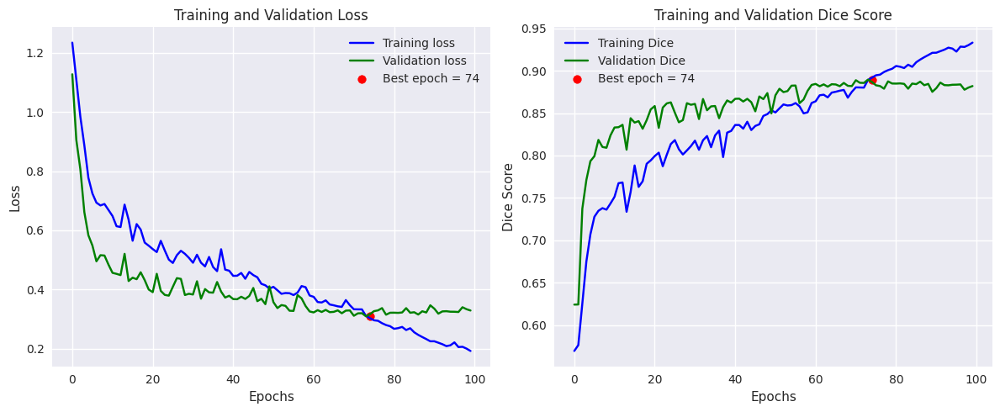

In [ ]:

best_val_loss_epoch = np.argmin(val_loss_log) + 1
best_val_dice_epoch = np.argmax(val_dice_log) + 1

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

axes[0].plot(train_loss_log, label='Training loss', color='blue')
axes[0].plot(val_loss_log, label='Validation loss', color='green')
axes[0].scatter(best_val_loss_epoch, val_loss_log[best_val_loss_epoch - 1], color='red', label=f'Best epoch = {best_val_loss_epoch}')
axes[0].set_title('Training and Validation Loss')
axes[0].set_xlabel('Epochs')
axes[0].set_ylabel('Loss')
axes[0].legend()

axes[1].plot(train_dice_log, label='Training Dice', color='blue')
axes[1].plot(val_dice_log, label='Validation Dice', color='green')
axes[1].scatter(best_val_dice_epoch, val_dice_log[best_val_dice_epoch - 1], color='red', label=f'Best epoch = {best_val_dice_epoch}')
axes[1].set_title('Training and Validation Dice Score')
axes[1].set_xlabel('Epochs')
axes[1].set_ylabel('Dice Score')
axes[1].legend()

plt.tight_layout()
plt.show()


## Plottings

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


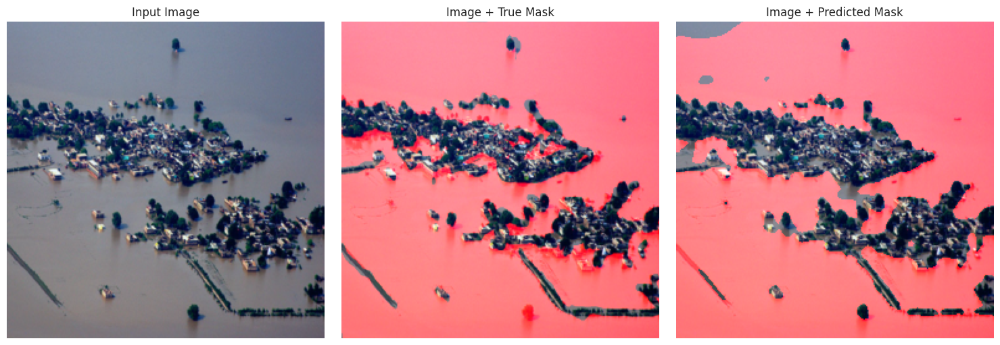

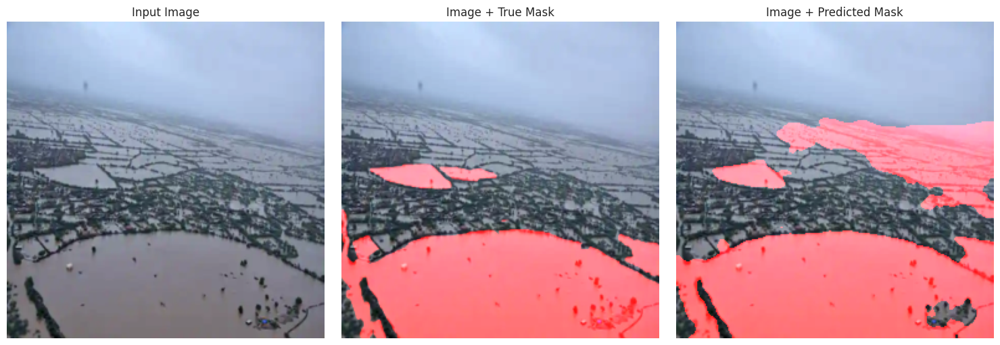

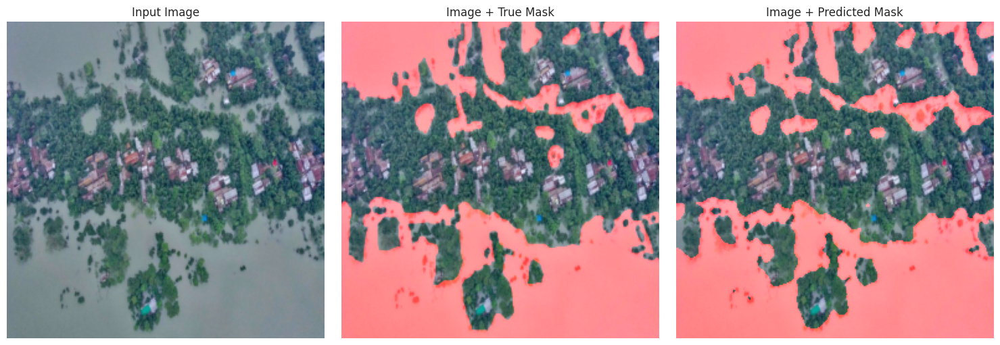

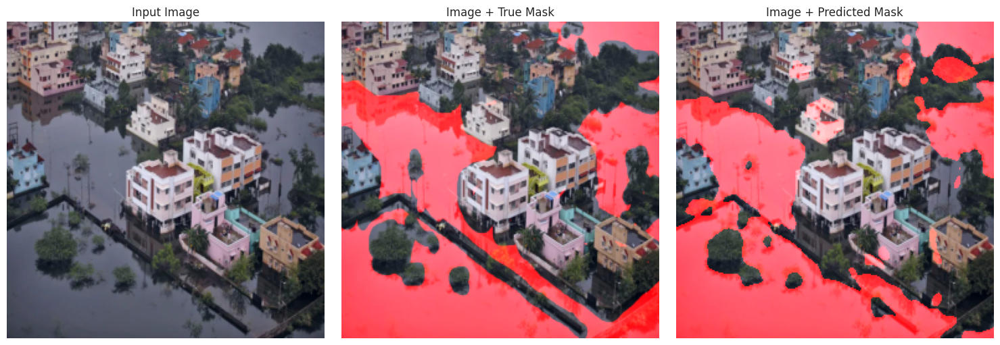

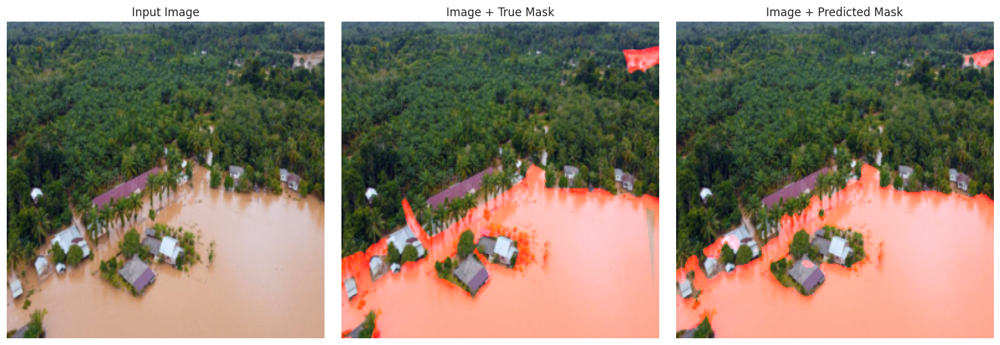

...

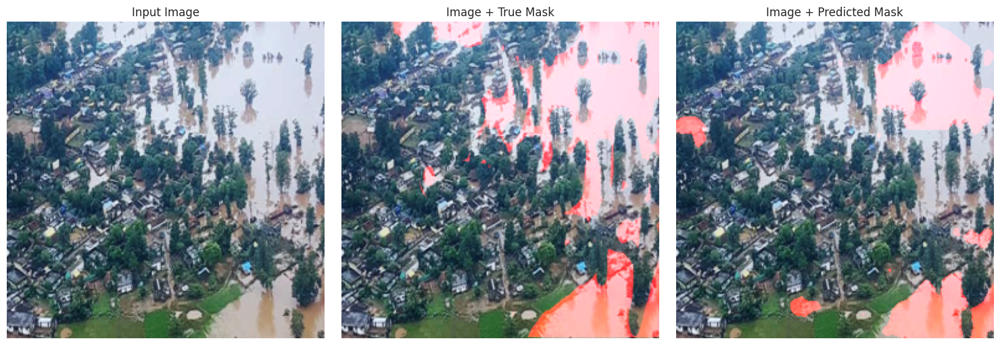

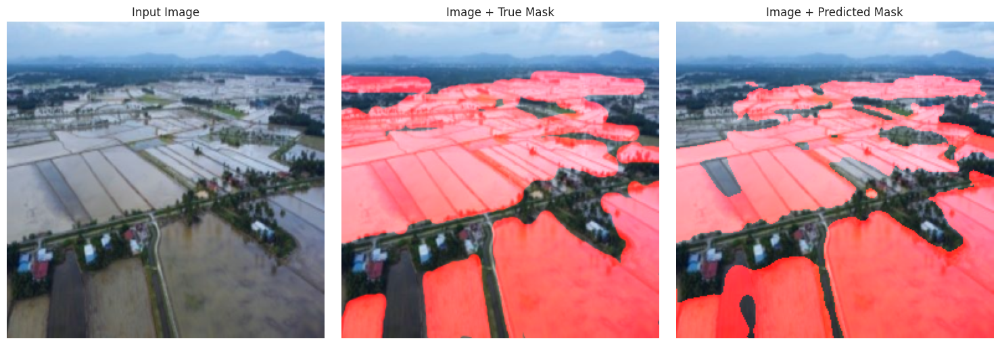

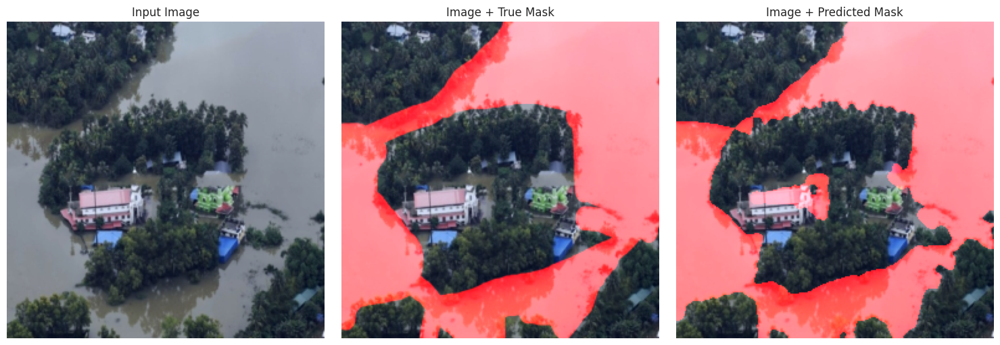

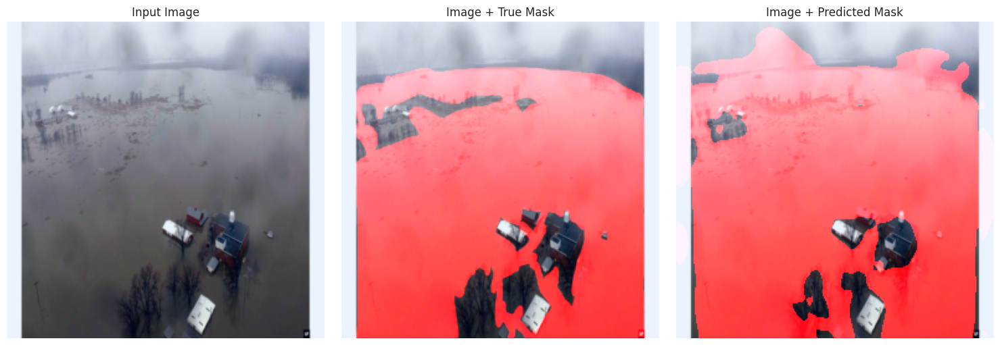

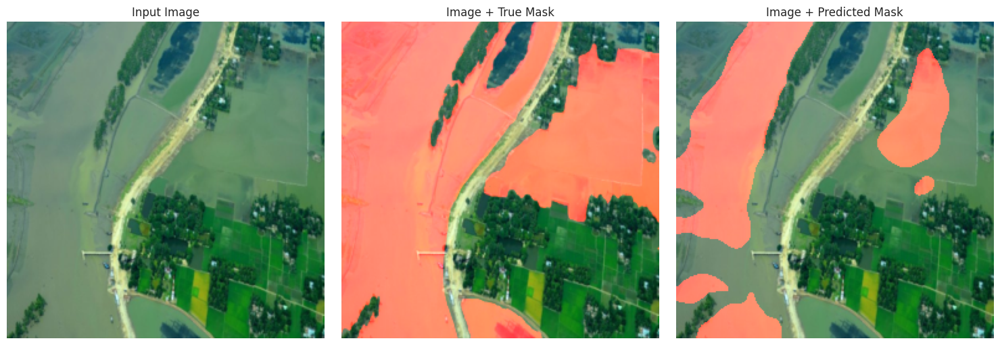

In [ ]:

def visualize_results(data_loader, trained_model, device_used, binarize_threshold=0.5, samples_to_display=3):

    trained_model.eval()
    with torch.no_grad():
        for batch_index, (input_images, true_masks) in enumerate(data_loader):
            if batch_index >= samples_to_display:
                break

            input_images, true_masks = input_images.to(device_used), true_masks.to(device_used)
            predictions = trained_model(input_images)

            for idx in range(len(input_images)):
                img_original = input_images[idx].permute(1, 2, 0).cpu().numpy()
                mask_actual = true_masks[idx].squeeze().cpu().numpy()
                mask_predicted = torch.sigmoid(predictions[idx]).cpu().numpy().squeeze()
                mask_binary = (mask_predicted > binarize_threshold).astype(float)

                if img_original.max() > 1:
                    img_original = (img_original - img_original.min()) / (img_original.max() - img_original.min() + 1e-8)

                img_overlay_actual = img_original.copy()
                img_overlay_predicted = img_original.copy()
                img_overlay_actual[:, :, 0] += mask_actual
                img_overlay_predicted[:, :, 0] += mask_binary

                fig, subplots = plt.subplots(1, 3, figsize=(15, 5))
                subplots[0].imshow(img_original)
                subplots[0].set_title("Input Image")
                subplots[0].axis("off")

                subplots[1].imshow(img_overlay_actual)
                subplots[1].set_title("Image + True Mask")
                subplots[1].axis("off")

                subplots[2].imshow(img_overlay_predicted)
                subplots[2].set_title("Image + Predicted Mask")
                subplots[2].axis("off")

                plt.tight_layout()
                plt.show()

visualize_results(val_loader, model, device, samples_to_display=1)


1. **Comparison with Conventional Loss Functions**:
    - How do Dice and Jaccard Losses differ from Cross-Entropy or Mean Squared Error, particularly in terms of sensitivity to class imbalances?

      Dice and Jaccard losses are more sensitive to class imbalances because they directly optimize the overlap between predicted and true segmentations, focusing on the foreground regions. In contrast, Cross-Entropy and Mean Squared Error treat all pixels equally, leading to bias toward larger background regions in imbalanced dataset

    - What advantages do these losses offer in capturing the spatial overlap between the predicted and true segmentations?

        Dice and Jaccard losses explicitly measure the spatial overlap between predicted and true segmentations, optimizing for the alignment of shapes and regions. This makes them particularly effective for tasks requiring precise boundary matching, unlike Cross-Entropy or MSE, which evaluate pixels independently without considering spatial relationships.

2. **Interpretation of Loss Values**:
    - Discuss what high or low loss scores reveal about the state and effectiveness of your segmentation model.

    High loss scores indicate poor performance, suggesting the model struggles to accurately predict segmentations. This could stem from insufficient training, inadequate model capacity, or noisy/imbalanced data.

    Low loss scores suggest the model effectively captures the spatial overlap between predictions and true masks, indicating accurate segmentations. However, overly low losses might also point to overfitting if the model performs well on training data but poorly on unseen data.


Evaluate the role of the attention mechanism in optimizing segmentation accuracy in cluttered environments. How does it refine the segmentation process?

The attention mechanism enhances segmentation accuracy in cluttered environments by focusing on relevant spatial regions while suppressing irrelevant or noisy areas. It assigns higher weights to significant features, ensuring the model concentrates on important parts of the input. This refinement improves the detection of smaller objects and boundaries, even in complex scenes with overlapping or distracting elements.

What is the importance of skip connections in U-Net, and how do they enhance the accuracy of segmentation tasks?

Skip connections in U-Net bridge the encoder and decoder layers, passing high-resolution spatial features from earlier layers to later ones. This helps the decoder recover fine details lost during downsampling, improving boundary accuracy and segmentation of small or intricate structures. They also mitigate vanishing gradients, enabling better training and convergence.


Explain the difference between the predicted and processed mask above.

The **predicted mask** represents the model's raw output, typically as a probability map where each pixel value indicates the likelihood of belonging to the target class.

The **processed mask** is obtained by applying a threshold (e.g., 0.5) to the predicted mask, converting it into a binary mask. This step refines the prediction into a discrete segmentation, making it suitable for direct comparison with the ground truth.